In [1]:
import os
import ruamel.yaml as yaml
import matplotlib.pyplot as plt
import numpy as np

## Obligatory paths

In [2]:
path_to_local_folder = os.path.expanduser('data_samples')
filter_include = ["synth", "A04hm_H1","nocond"]
filter_exclude = ["failed"]

conf_name = "common_files/config_mcmc_bayes.yaml"

# načtení dat a formatovani dat

In [3]:
from raw_data import MultiRawData
from results_aggregator import get_subfolder_paths_processed, filter_datasets

subfolders = get_subfolder_paths_processed(path_to_local_folder)
subfolders_filt = filter_datasets(subfolders, filter_include, filter_exclude)

all_raw_data = MultiRawData()
all_raw_data.load_from_folders_hdf5(subfolders_filt)
# load yaml config from the first folder in the list, it will be used for likelihood evaluation
conf = yaml.safe_load(open(os.path.join(subfolders_filt[0], conf_name), 'r'))
subfolders_filt

['data_samples/borehole_H1/synth_A04hm_H1_nocond_20230419',
 'data_samples/borehole_H1/synth_A04hm_H1_nocond_nocorr_20230602',
 'data_samples/borehole_H1_proposal_std/synth_A04hm_H1_nocond_nocorr_20230618a',
 'data_samples/borehole_H1_proposal_std/synth_A04hm_H1_nocond_nocorr_20230618b',
 'data_samples/borehole_H1_proposal_std/synth_A04hm_H1_nocond_nocorr_20230618c',
 'data_samples/borehole_H1_proposal_std/synth_A04hm_H1_nocond_nocorr_20230619',
 'data_samples/borehole_H1_proposal_std/synth_A04hm_H1_nocond_nocorr_20230619b',
 'data_samples/borehole_H1_proposal_std/synth_A04hm_H1_nocond_nocorr_20230619c']

## Filtrovaní dat

In [4]:
# filter data so only those with model are used and only ones with tag 1 = coverged
raw_data_filtered = all_raw_data.filter(types=[0, 2], tags=[1])
raw_data_filtered.print_statistics()

raw data: no_samples 167632
raw data: no_nonconverging 0
raw data: p (167632, 8)
raw data: w (167632, 1)
raw_data: np.sum(weights): 1950105.0
raw_data: all_sizes: {'types': (167632,), 'stages': (167632,), 'chains': (167632,), 'tags': (167632,), 'parameters': (167632, 8), 'observations': (167632, 26), 'parameters_normalized': (167632, 8), 'weights': (167632, 1), 'run_ids': (167632,)}


## Rekonstrukce modelu šumu pro výpočet likelihoodu

In [5]:
import surrDAMH_gaussian_process as gp

def compute_log_likelihood_all(data):
    # reconstruct covariance of the noise
    cov_mat = gp.assemble_covariance_matrix(conf['noise_model'])

    # rewritten likelihood for our model
    def get_log_likelihood_multivariate(observations, G_sample,noise_std):
        v = observations - G_sample.ravel()
        invCv = np.linalg.solve(noise_std,v)
        return -0.5*np.dot(v,invCv)

    # measurement from conf
    y_orig = np.array(conf['problem_parameters']['observations'])

    log_likelihood = np.zeros((data.shape[0],1))
    for idx,obs in enumerate(data):
        log_likelihood[idx] = get_log_likelihood_multivariate(obs,y_orig,cov_mat)
    
    return log_likelihood

## Vytvoření datasetu pro trénování a testování

In [6]:
data = raw_data_filtered.parameters_normalized
obs = raw_data_filtered.observations

obs_likelihood = compute_log_likelihood_all(obs)


9.357622968840175e-14 2.061153622438558e-09 4.5399929762484854e-05 0.01831563888873418


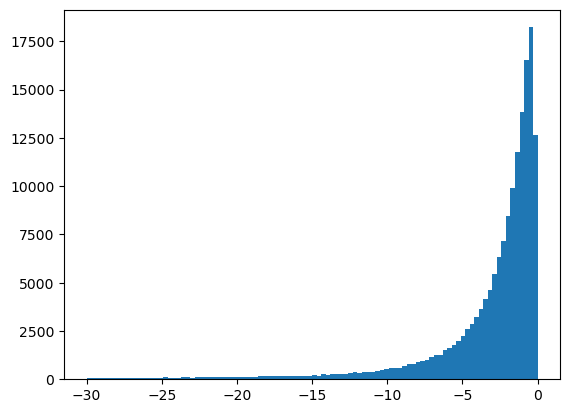

In [7]:
_ = plt.hist(obs_likelihood, bins=100, range=(-30, 0))
print(np.exp(-30), np.exp(-20), np.exp(-10), np.exp(-4))

In [8]:
# filter only data and obs with obs_likelihood > -10
data_filt = data[obs_likelihood.ravel() > -10, :]  # type: ignore
obs_filt = obs[obs_likelihood.ravel() > -10, :]  # type: ignore
obs_filt.shape

(151231, 26)

In [9]:

from sklearn.model_selection import train_test_split

input_data = data_filt
output_data = obs_filt

# rozdělit data na trénovací a testovací set
X_train, X_test, y_train, y_test = train_test_split(input_data, output_data, test_size=1-0.1, random_state=42)

likelihood_train = compute_log_likelihood_all(y_train)
likelihood_test = compute_log_likelihood_all(y_test)
likelihood_train.shape

(15123, 1)

In [10]:
# simulace acceptance probability

def acceptance_prob_all(prediction_likelihood):
    # create random permutation of filt_likelihood,acc_likelihood
    idx = np.random.permutation(len(prediction_likelihood))
    old_pred = prediction_likelihood[idx]
    old_test = likelihood_test[idx]

    alpha_s = np.minimum(likelihood_test + old_pred - prediction_likelihood - old_test,0)

    return np.exp(alpha_s)

def acceptance_prob_all_train(prediction_likelihood):
    # create random permutation of filt_likelihood,acc_likelihood
    idx = np.random.permutation(len(prediction_likelihood))
    old_pred = prediction_likelihood[idx]
    old_test = likelihood_train[idx]

    alpha_s = np.minimum(likelihood_train + old_pred - prediction_likelihood - old_test,0)

    return np.exp(alpha_s)

In [11]:
import matplotlib.pylab as pylab
params_pylab = {'font.size': 12,
                'legend.fontsize': 'large',
                'axes.labelsize': 'large',
                'axes.titlesize': 'x-large',
                'xtick.labelsize': 'medium',
                'ytick.labelsize': 'medium',
                'figure.dpi': 600}
pylab.rcParams.update(params_pylab)

def plot_results_only_likelihood_(res_surr):
    fig, axs = plt.subplots(1, 2, figsize=(14, 5))

    # First subplot
    axs[0].scatter(likelihood_test, res_surr, alpha=0.01, marker='.')
    axs[0].plot([-10, 0], [-10, 0], color='red')
    axs[0].set_ylim(-10, 0)
    axs[0].set_xlim(-10, 0)

    # Second subplot
    alpha_all = acceptance_prob_all(res_surr)
    axs[1].hist(alpha_all)
    mean_acceptance = np.mean(alpha_all)
    axs[1].set_title(f'mean acceptance = {mean_acceptance}')
    plt.show()


def plot_results_only_likelihood(res_surr):
    fig, axs = plt.subplots(1, 2, figsize=(12, 4))

    # First subplot
    axs[0].scatter(likelihood_test, res_surr, alpha=0.01, marker='.')
    axs[0].plot([-10, 0], [-10, 0], color='red')
    axs[0].set_ylim(-10, 0)
    axs[0].set_xlim(-10, 0)
    axs[0].set_xlabel('Exact')
    axs[0].set_ylabel('Meta-model')
    axs[0].set_title('Log-likelihood approximation')

    # Second subplot
    alpha_all = acceptance_prob_all(res_surr)
    axs[1].hist(alpha_all, bins=30, density=True)
    mean_acceptance = np.mean(alpha_all)
    rounded_mean_acceptance = round(mean_acceptance, 3)
    axs[1].text(0.05, 0.95, f'Mean Acceptance = {rounded_mean_acceptance:.3f}',
                transform=axs[1].transAxes, verticalalignment='top')
    axs[1].set_xlabel('Probability of acceptance')
    axs[1].set_ylabel('PDF of acceptance')
    axs[1].set_title('Simulated DAMH acceptance prob.')

    plt.show()


def plot_results_all(res_surr):
    plot_results_only_likelihood(compute_log_likelihood_all(res_surr))


def plot_results_only_likelihood_train(res_surr):
    fig, axs = plt.subplots(1, 2, figsize=(12, 4))

    # First subplot
    axs[0].scatter(likelihood_train, res_surr, alpha=0.01, marker='.')
    axs[0].plot([-10, 0], [-10, 0], color='red')
    axs[0].set_ylim(-10, 0)
    axs[0].set_xlim(-10, 0)
    axs[0].set_xlabel('Exact')
    axs[0].set_ylabel('Meta-model')
    axs[0].set_title('Log-likelihood approximation')

    # Second subplot
    alpha_all = acceptance_prob_all_train(res_surr)
    axs[1].hist(alpha_all, bins=30, density=True)
    mean_acceptance = np.mean(alpha_all)
    rounded_mean_acceptance = round(mean_acceptance, 3)
    axs[1].text(0.05, 0.95, f'Mean Acceptance = {rounded_mean_acceptance:.3f}',
                transform=axs[1].transAxes, verticalalignment='top')
    axs[1].set_xlabel('Probability of acceptance')
    axs[1].set_ylabel('PDF of acceptance')
    axs[1].set_title('Simulated DAMH acceptance prob.')

    plt.show()


def plot_results_all_train(res_surr):
    plot_results_only_likelihood_train(compute_log_likelihood_all(res_surr))

## Polynomial model from sklearn

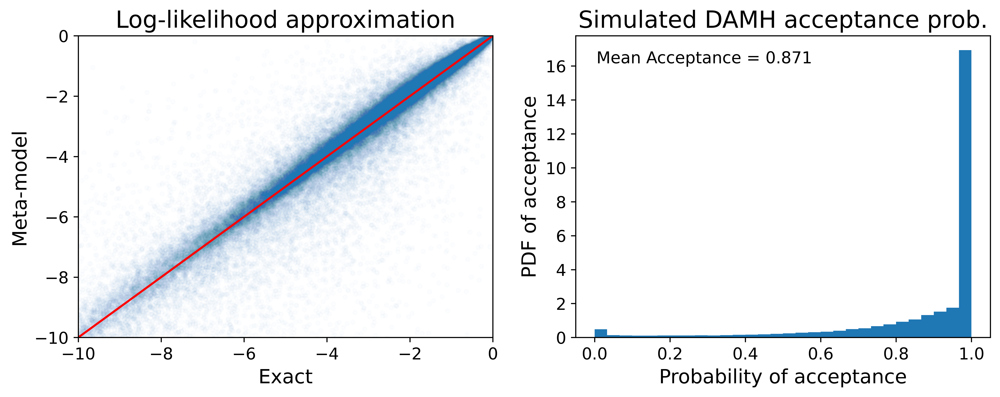

In [179]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline

def polynomial_regression(X, y, degree):
    # Create a pipeline that first creates polynomial features and then fits a linear regression model
    model = make_pipeline(PolynomialFeatures(degree), LinearRegression())
    model.fit(X, y)
    return model

tmp = polynomial_regression(X_train, y_train, 5)
res_surr = tmp.predict(X_test)

# compute alphas and plot results
plot_results_all(res_surr)


Degree:  2


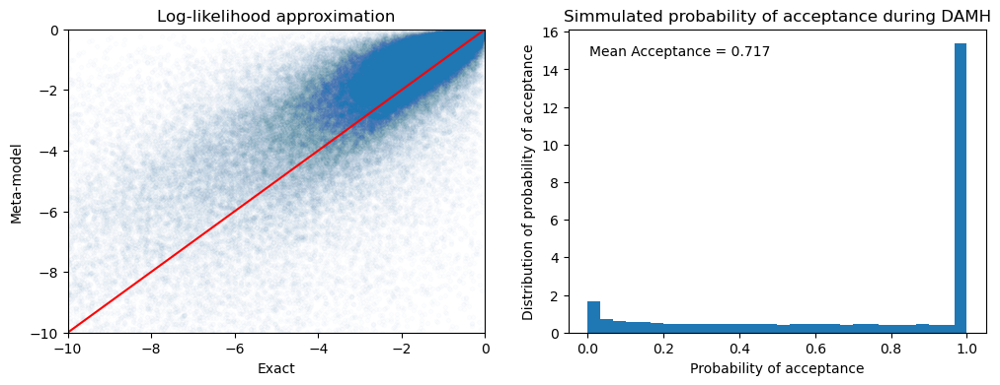

Degree:  3


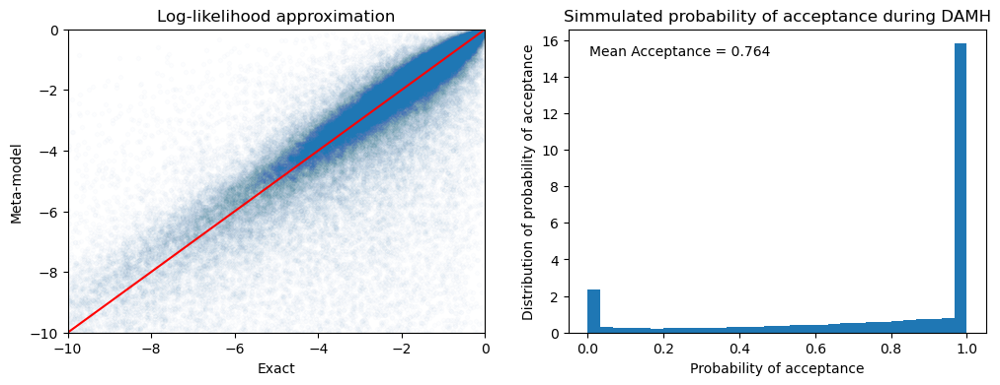

Degree:  4


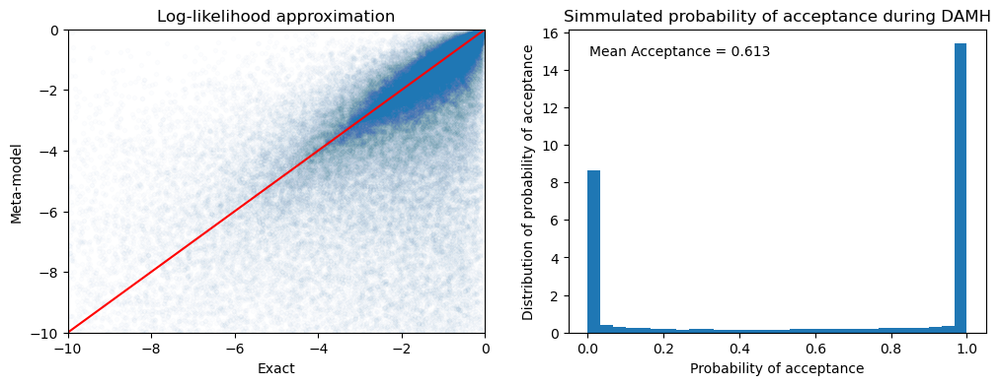

Degree:  5


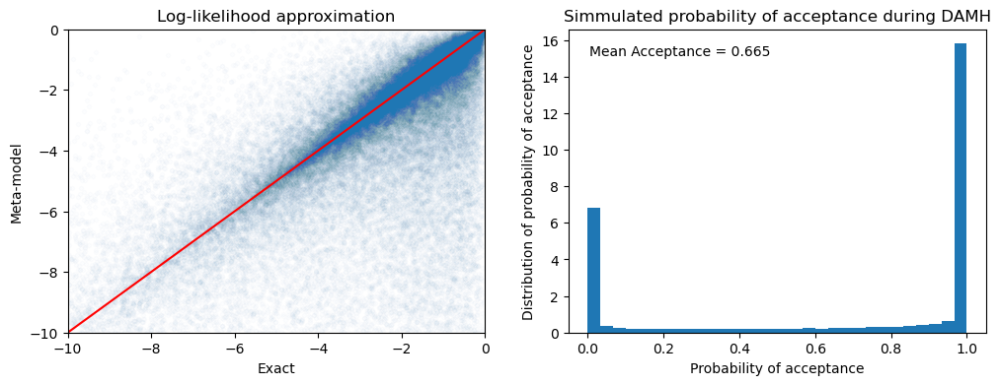

In [37]:

for degree in range(2, 6):
    print("Degree: ", degree)
    tmp = polynomial_regression(X_train, y_train, degree)
    res_surr = tmp.predict(X_test)

    # compute alphas and plot results
    plot_results_all(res_surr)


## RBF pomocí scipy

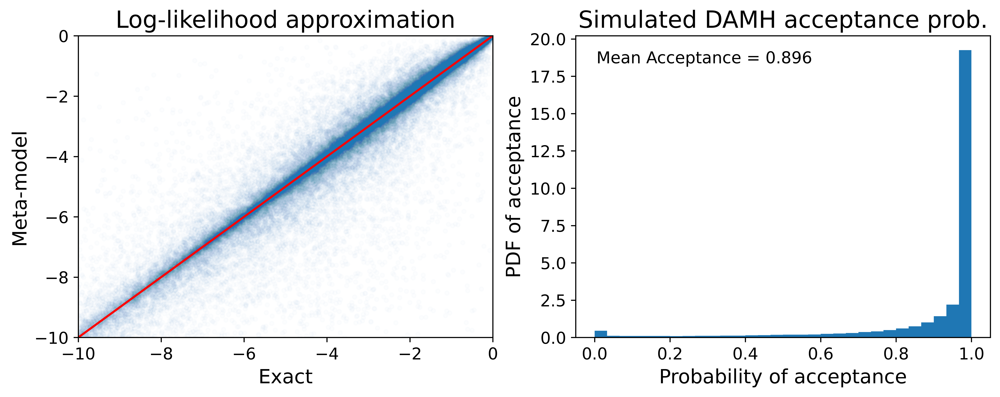

In [178]:
from scipy.interpolate import RBFInterpolator

# Použití funkce surrogate_model
"""    kernel: typ jaderné funkce ('linear', 'thin_plate_spline', 'cubic', 'quintic', 'multiquadric', 
             'inverse_multiquadric', 'inverse_quadratic', 'gaussian')"""
tmp = RBFInterpolator(X_train, y_train, kernel='thin_plate_spline', smoothing=1e-9, degree=5, epsilon=1e-1)
res_surr = tmp(X_test)


# compute alphas and plot results
plot_results_all(res_surr)

## více typů RBF v scipy
obdobná implementace, ale scipy je rychlejší

Kernel: linear


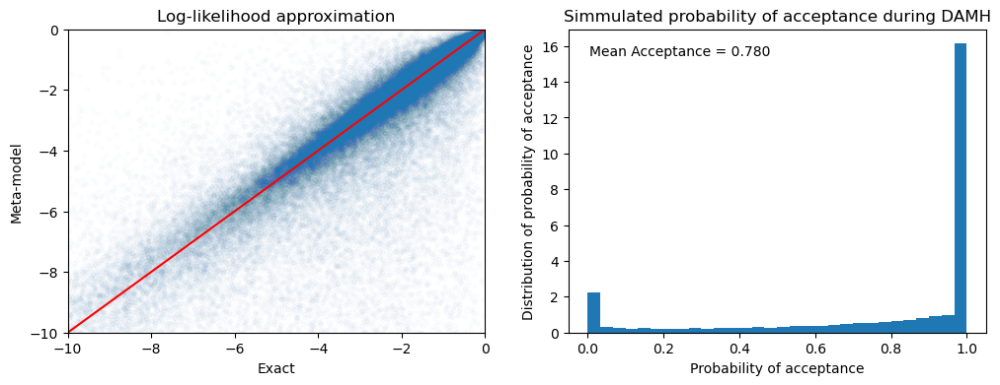

Kernel: thin_plate_spline


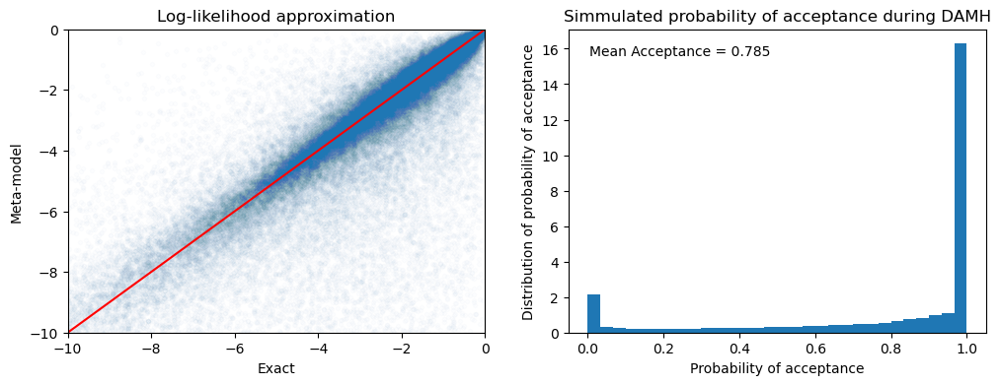

Kernel: cubic


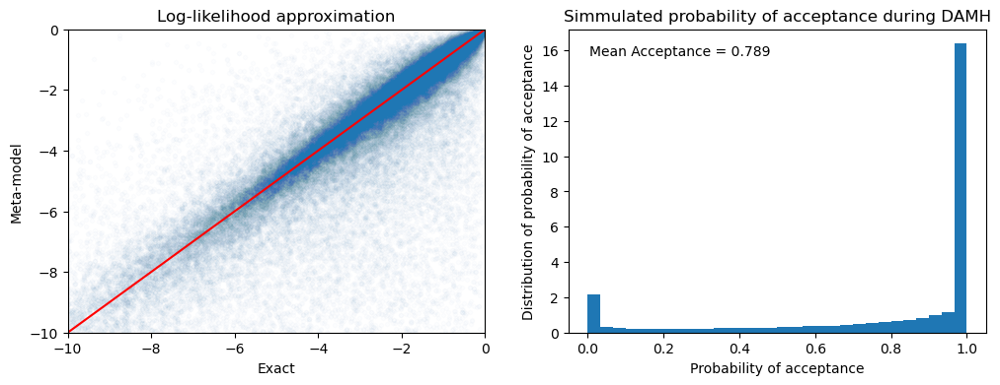

In [39]:
# Použití funkce surrogate_model
"""    kernel: typ jaderné funkce ('linear', 'thin_plate_spline', 'cubic', 'quintic', 'multiquadric', 
             'inverse_multiquadric', 'inverse_quadratic', 'gaussian')"""
from math import e


list_kernels = ['linear', 'thin_plate_spline', 'cubic']


for type_kernel in list_kernels:
    print(f"Kernel: {type_kernel}")
    tmp = RBFInterpolator(X_train, y_train, kernel=type_kernel, smoothing=1e-9, degree=3, epsilon=1e-1)
    res_surr = tmp(X_test)
    # compute alphas and plot results
    plot_results_all(res_surr)

# Zkouška pomocí neural network v sklearn

# pytorch


Using cuda device
Iteration 0, Loss: 8894.685546875, Learning rate: 0.1.
Iteration 10000, Loss: 1.3413599729537964, Learning rate: 0.1.
Iteration 20000, Loss: 1.843681812286377, Learning rate: 0.1.
Iteration 30000, Loss: 3.3870277404785156, Learning rate: 0.1.
Iteration 40000, Loss: 0.46232491731643677, Learning rate: 0.1.
Iteration 50000, Loss: 0.3440341353416443, Learning rate: 0.1.
Iteration 60000, Loss: 0.41588884592056274, Learning rate: 0.1.
Iteration 70000, Loss: 1.0020248889923096, Learning rate: 0.1.
Iteration 80000, Loss: 1.0751796960830688, Learning rate: 0.1.
Iteration 90000, Loss: 0.13316769897937775, Learning rate: 0.1.
Iteration 100000, Loss: 0.7510384321212769, Learning rate: 0.1.
Iteration 110000, Loss: 0.23480017483234406, Learning rate: 0.1.
Iteration 120000, Loss: 0.13734886050224304, Learning rate: 0.1.
Iteration 130000, Loss: 0.1848016083240509, Learning rate: 0.1.
Iteration 140000, Loss: 0.7250394225120544, Learning rate: 0.1.
Iteration 150000, Loss: 0.1722289621

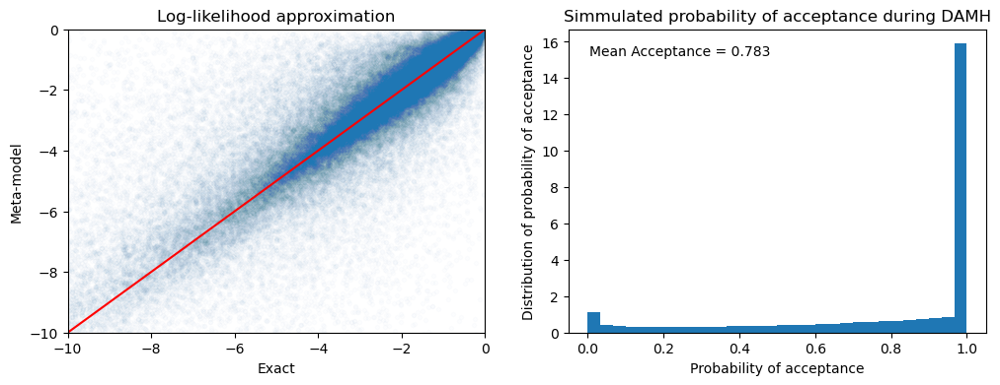

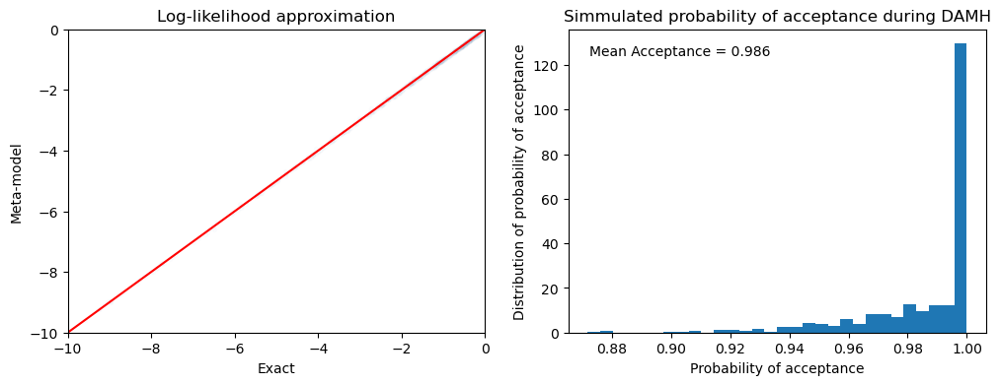

In [41]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

n_lyer = 50
# Step 1: Define the Neural Network Architecture
class MLPRegressor(nn.Module):
    def __init__(self):
        super(MLPRegressor, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], n_lyer),
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, y_train.shape[1])
        )
        
    def forward(self, x):
        return self.layers(x)
    
# Step 2: Move the Model to GPU if Available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using {device} device')
model = MLPRegressor().to(device)

# Step 3: Define a Loss Function and Optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.1)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=25000, factor=0.5)

# Step 4: Convert Numpy Data to PyTorch Tensors and Move to Device
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)

# Step 5: Train the Model
max_iter = 1000000
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if iteration % 10000 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-4:
                print(" (STOP)")
                break
        print(".")
        

# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)


Using cuda device
Iteration 0, Loss: 8892.92578125, Learning rate: 0.1.
Iteration 10000, Loss: 1.4649776220321655, Learning rate: 0.1.
Iteration 20000, Loss: 0.03858388215303421, Learning rate: 0.1.
Iteration 30000, Loss: 0.19109322130680084, Learning rate: 0.1.
Iteration 40000, Loss: 0.2768000662326813, Learning rate: 0.1.
Iteration 50000, Loss: 0.05672662705183029, Learning rate: 0.05.
Iteration 60000, Loss: 0.06960131973028183, Learning rate: 0.025.
Iteration 70000, Loss: 0.044729966670274734, Learning rate: 0.0125.
Iteration 80000, Loss: 0.03990992158651352, Learning rate: 0.00625.
Iteration 90000, Loss: 0.03740585595369339, Learning rate: 0.003125.
Iteration 100000, Loss: 0.036029212176799774, Learning rate: 0.0015625.
Iteration 110000, Loss: 0.0347532294690609, Learning rate: 0.00078125.
Iteration 120000, Loss: 0.0336887426674366, Learning rate: 0.000390625.
Iteration 130000, Loss: 0.03292462229728699, Learning rate: 0.0001953125.
Iteration 140000, Loss: 0.03250320255756378, Lear

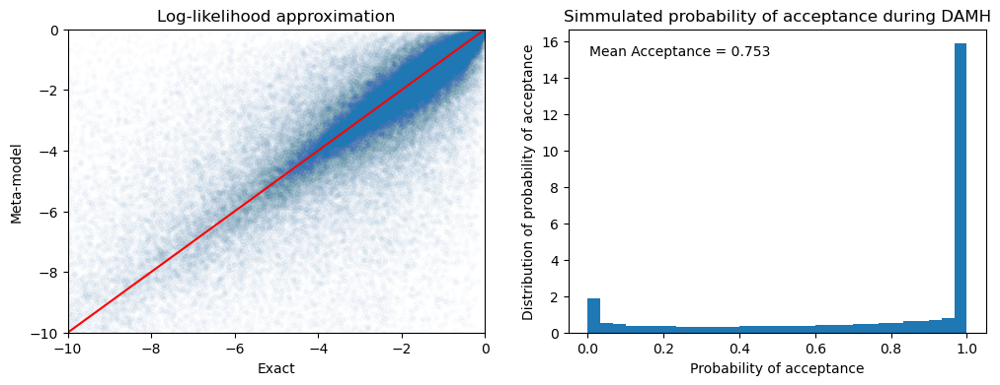

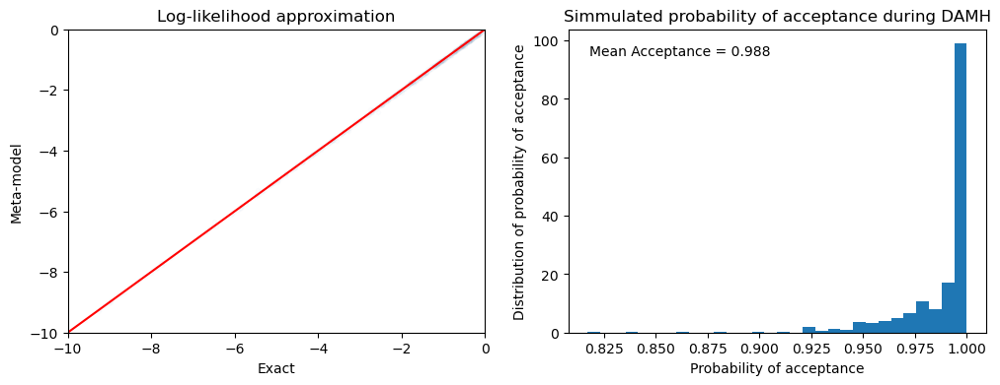

In [44]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

n_lyer = 100
# Step 1: Define the Neural Network Architecture
class MLPRegressor(nn.Module):
    def __init__(self):
        super(MLPRegressor, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], n_lyer),
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, y_train.shape[1])
        )
        
    def forward(self, x):
        return self.layers(x)
    
# Step 2: Move the Model to GPU if Available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using {device} device')
model = MLPRegressor().to(device)

# Step 3: Define a Loss Function and Optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.1)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10000, factor=0.5)

# Step 4: Convert Numpy Data to PyTorch Tensors and Move to Device
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)

break_the_loop = False

# Step 5: Train the Model
max_iter = 1000000
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if iteration % 10000 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-4:
                print(" (STOP)")
                break_the_loop = True
        if break_the_loop:
            break
        print(".")
        

# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)


Using cuda device
Iteration 0, Loss: 8894.5263671875, Learning rate: 0.1.
Iteration 10000, Loss: 1.2577282190322876, Learning rate: 0.1.
Iteration 20000, Loss: 0.08138113468885422, Learning rate: 0.1.
Iteration 30000, Loss: 0.26829782128334045, Learning rate: 0.1.
Iteration 40000, Loss: 0.045337870717048645, Learning rate: 0.05.
Iteration 50000, Loss: 0.029873808845877647, Learning rate: 0.025.
Iteration 60000, Loss: 0.0640726163983345, Learning rate: 0.0125.
Iteration 70000, Loss: 0.020551005378365517, Learning rate: 0.00625.
Iteration 80000, Loss: 0.018908992409706116, Learning rate: 0.003125.
Iteration 90000, Loss: 0.016351712867617607, Learning rate: 0.0015625.
Iteration 100000, Loss: 0.015401884913444519, Learning rate: 0.00078125.
Iteration 110000, Loss: 0.014879660680890083, Learning rate: 0.000390625.
Iteration 120000, Loss: 0.01454574428498745, Learning rate: 0.0001953125.
Iteration 130000, Loss: 0.01432052068412304, Learning rate: 9.765625e-05 (STOP)


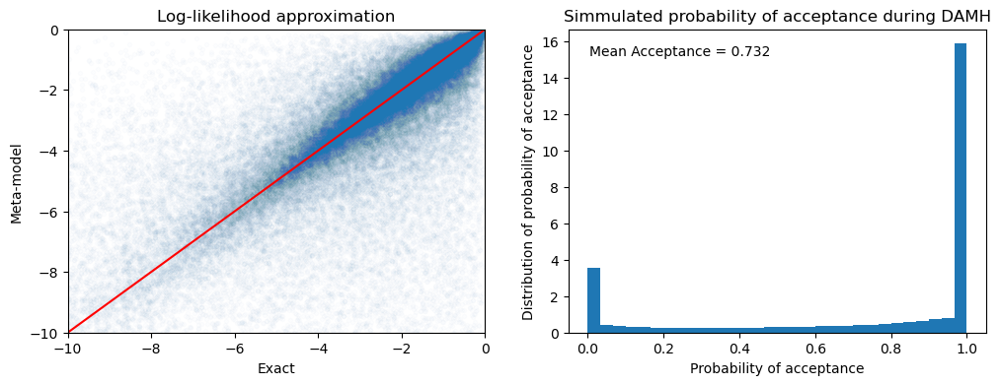

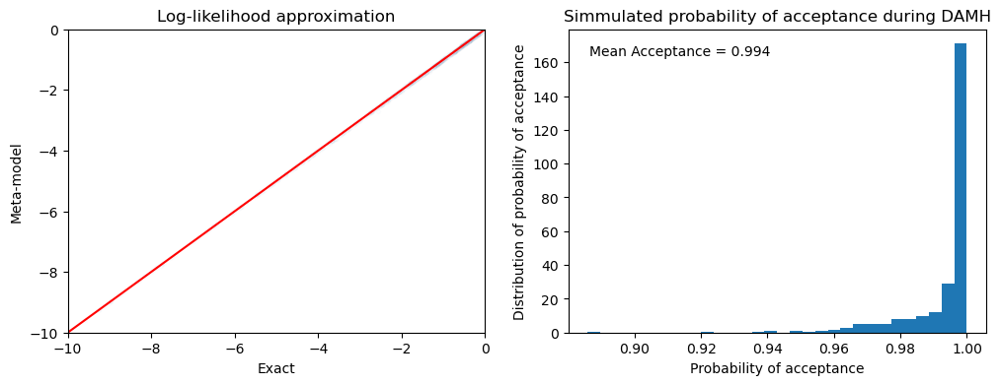

In [45]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

n_lyer = 100
# Step 1: Define the Neural Network Architecture
class MLPRegressor(nn.Module):
    def __init__(self):
        super(MLPRegressor, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], n_lyer),
            nn.LeakyReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.LeakyReLU(),
            nn.Linear(n_lyer, y_train.shape[1])
        )
        
    def forward(self, x):
        return self.layers(x)
    
# Step 2: Move the Model to GPU if Available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using {device} device')
model = MLPRegressor().to(device)

# Step 3: Define a Loss Function and Optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.1)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10000, factor=0.5)

# Step 4: Convert Numpy Data to PyTorch Tensors and Move to Device
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)

break_the_loop = False

# Step 5: Train the Model
max_iter = 1000000
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if iteration % 10000 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-4:
                print(" (STOP)")
                break_the_loop = True
        if break_the_loop:
            break
        print(".")
        

# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)


Using cuda device
Iteration 0, Loss: 8889.080078125, Learning rate: 0.1.
Iteration 10000, Loss: 0.6830204129219055, Learning rate: 0.1.
Iteration 20000, Loss: 0.6792845129966736, Learning rate: 0.1.
Iteration 30000, Loss: 0.8436945676803589, Learning rate: 0.1.
Iteration 40000, Loss: 0.22282548248767853, Learning rate: 0.05.
Iteration 50000, Loss: 0.08137211948633194, Learning rate: 0.05.
Iteration 60000, Loss: 0.0685909241437912, Learning rate: 0.05.
Iteration 70000, Loss: 0.0738259106874466, Learning rate: 0.05.
Iteration 80000, Loss: 0.06008734181523323, Learning rate: 0.05.
Iteration 90000, Loss: 0.05522523447871208, Learning rate: 0.025.
Iteration 100000, Loss: 0.11886301636695862, Learning rate: 0.025.
Iteration 110000, Loss: 0.43167972564697266, Learning rate: 0.025.
Iteration 120000, Loss: 0.05119490623474121, Learning rate: 0.025.
Iteration 130000, Loss: 0.0413634292781353, Learning rate: 0.0125.
Iteration 140000, Loss: 0.05305646359920502, Learning rate: 0.0125.
Iteration 150

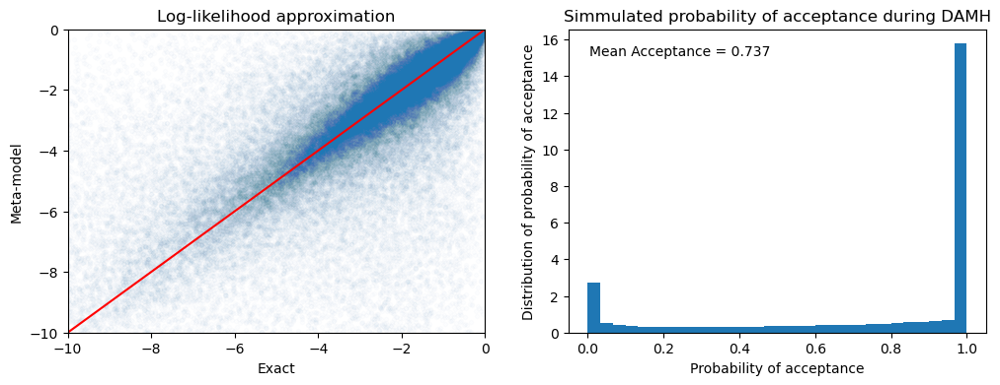

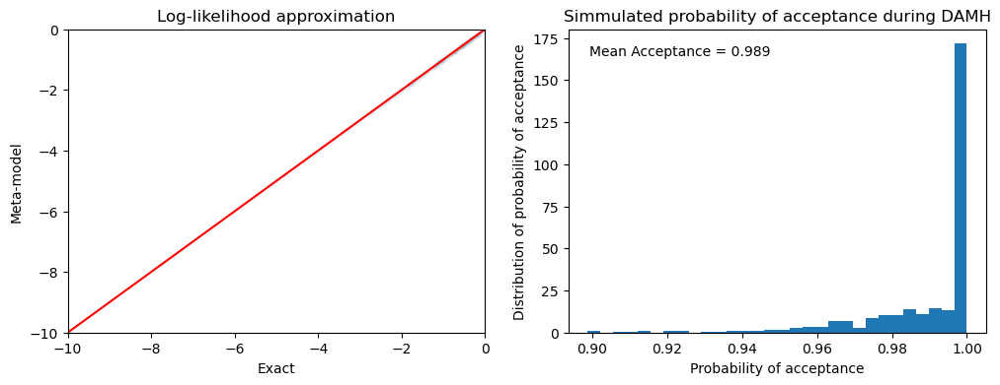

In [43]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

n_lyer = 50
# Step 1: Define the Neural Network Architecture
class MLPRegressor(nn.Module):
    def __init__(self):
        super(MLPRegressor, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], n_lyer),
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, y_train.shape[1])
        )
        
    def forward(self, x):
        return self.layers(x)
    
# Step 2: Move the Model to GPU if Available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using {device} device')
model = MLPRegressor().to(device)

# Step 3: Define a Loss Function and Optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.1)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=10000, factor=0.5)

# Step 4: Convert Numpy Data to PyTorch Tensors and Move to Device
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)

break_the_loop = False

# Step 5: Train the Model
max_iter = 1000000
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if iteration % 10000 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-4:
                print(" (STOP)")
                break_the_loop = True
        if break_the_loop:
            break
        print(".")
        

# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)


Using cuda device
Iteration 9999, Loss: 3.469257354736328, Learning rate: 0.1.
Iteration 19999, Loss: 0.6571286916732788, Learning rate: 0.1.
Iteration 29999, Loss: 2.9814839363098145, Learning rate: 0.1.
Iteration 39999, Loss: 0.7998073697090149, Learning rate: 0.1.
Iteration 49999, Loss: 1.9821394681930542, Learning rate: 0.1.
Iteration 59999, Loss: 1.0102118253707886, Learning rate: 0.1.
Iteration 69999, Loss: 0.5592145323753357, Learning rate: 0.1.
Iteration 79999, Loss: 0.519170880317688, Learning rate: 0.1.
Iteration 89999, Loss: 0.5075013041496277, Learning rate: 0.1.
Iteration 99999, Loss: 0.631547212600708, Learning rate: 0.1.
Iteration 109999, Loss: 0.3776395320892334, Learning rate: 0.1.
Iteration 119999, Loss: 0.4763723611831665, Learning rate: 0.1.
Iteration 129999, Loss: 0.424678772687912, Learning rate: 0.1.
Iteration 139999, Loss: 1.1114548444747925, Learning rate: 0.1.
Iteration 149999, Loss: 0.25615251064300537, Learning rate: 0.05.
Iteration 159999, Loss: 0.242757052

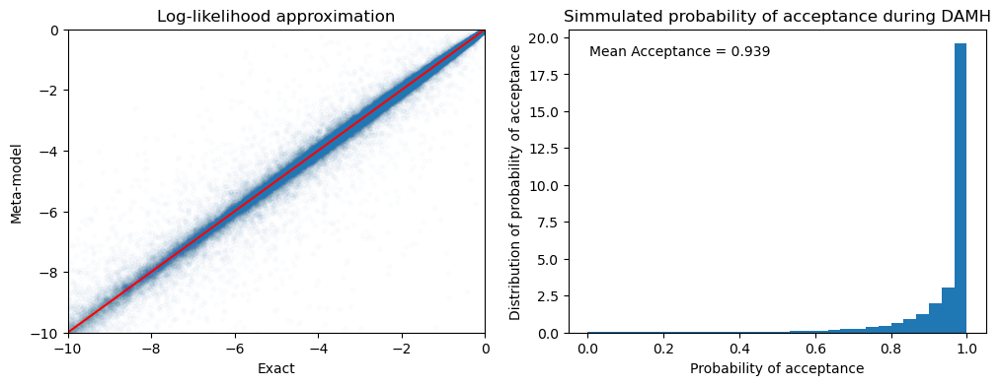

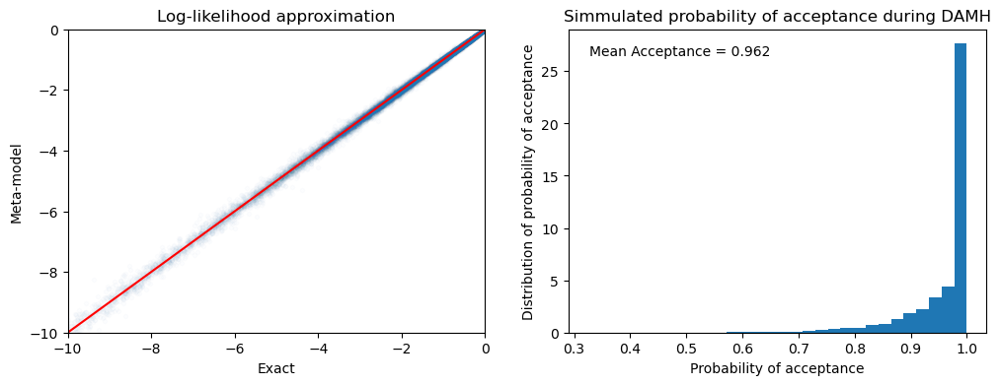

In [46]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

n_lyer = 100
# Step 1: Define the Neural Network Architecture
class MLPRegressor(nn.Module):
    def __init__(self):
        super(MLPRegressor, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], n_lyer),
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, y_train.shape[1])
        )
        
    def forward(self, x):
        return self.layers(x)
    
# Step 2: Move the Model to GPU if Available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using {device} device')
model = MLPRegressor().to(device)

# Step 3: Define a Loss Function and Optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.1)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=30000, factor=0.5)

# Step 4: Convert Numpy Data to PyTorch Tensors and Move to Device
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)

break_the_loop = False

# Step 5: Train the Model
max_iter = 2000000
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if (iteration + 1) % 10000 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-4:
                print(" (STOP)")
                break_the_loop = True
        if break_the_loop:
            break
        print(".")
        

# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)


Using cuda device
Iteration 99, Loss: 9.289340019226074, Learning rate: 0.02.
Iteration 199, Loss: 8.333902359008789, Learning rate: 0.02.
Iteration 299, Loss: 7.499444484710693, Learning rate: 0.02.
Iteration 399, Loss: 7.322482109069824, Learning rate: 0.02.
Iteration 499, Loss: 7.331347942352295, Learning rate: 0.02.
Iteration 599, Loss: 7.194982051849365, Learning rate: 0.02.
Iteration 699, Loss: 7.511674880981445, Learning rate: 0.02.
Iteration 799, Loss: 7.402204513549805, Learning rate: 0.02.
Iteration 899, Loss: 5.9436492919921875, Learning rate: 0.02.
Iteration 999, Loss: 9.45151424407959, Learning rate: 0.02.
Iteration 1099, Loss: 5.015926361083984, Learning rate: 0.02.
Iteration 1199, Loss: 4.785373687744141, Learning rate: 0.02.
Iteration 1299, Loss: 4.115993022918701, Learning rate: 0.02.
Iteration 1399, Loss: 3.9017081260681152, Learning rate: 0.02.
Iteration 1499, Loss: 3.9379000663757324, Learning rate: 0.02.
Iteration 1599, Loss: 3.1707565784454346, Learning rate: 0.02

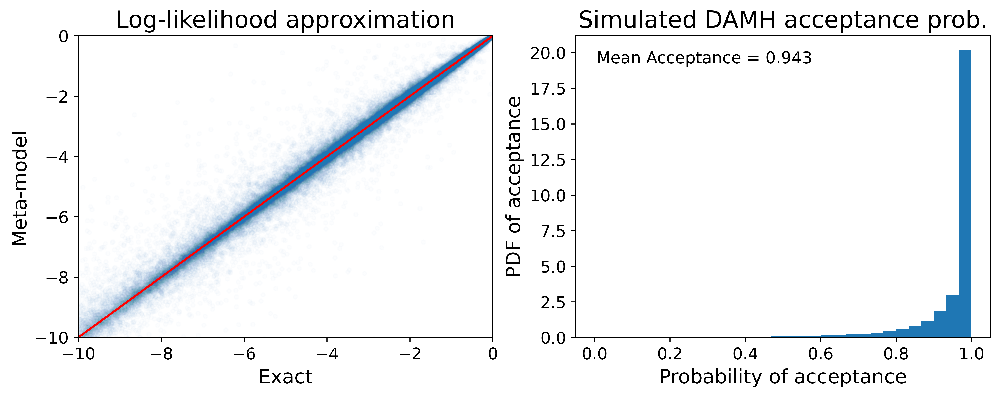

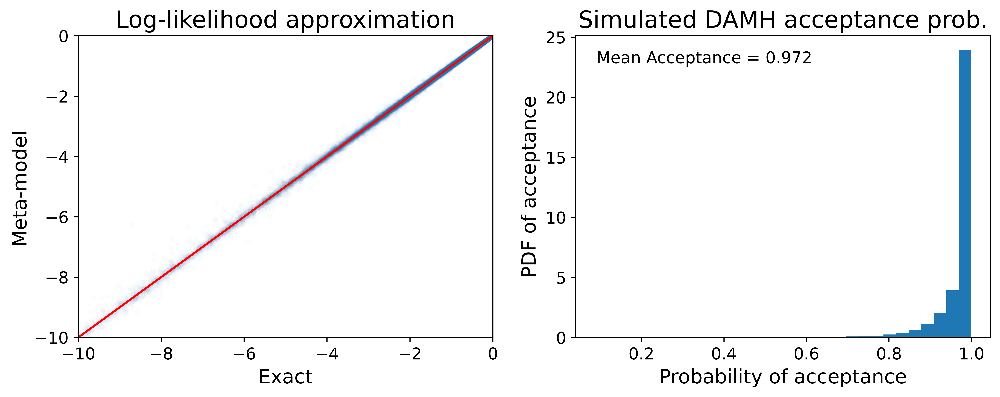

In [177]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

n_lyer = 100
# Step 1: Define the Neural Network Architecture
class MLPRegressor(nn.Module):
    def __init__(self):
        super(MLPRegressor, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], n_lyer),
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),
            nn.ReLU(),
            nn.Linear(n_lyer, y_train.shape[1])
        )
        
    def forward(self, x):
        return self.layers(x)
    
# Step 2: Move the Model to GPU if Available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using {device} device')
model = MLPRegressor().to(device)

# Step 3: Define a Loss Function and Optimizer
criterion = nn.L1Loss()
optimizer = optim.Adam(model.parameters(), lr=0.02)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=1000, factor=0.75)

# Step 4: Convert Numpy Data to PyTorch Tensors and Move to Device
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)

break_the_loop = False

# Step 5: Train the Model
max_iter = 2000000
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if (iteration + 1) % 100 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-4:
                print(" (STOP)")
                break_the_loop = True
        if break_the_loop:
            break
        print(".")
        

# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)


Iteration 999, Loss: 1.2326159477233887, Learning rate: 0.02.
Iteration 1999, Loss: 0.40551015734672546, Learning rate: 0.015.
Iteration 2999, Loss: 0.2566205859184265, Learning rate: 0.01125.
Iteration 3999, Loss: 0.21445946395397186, Learning rate: 0.0084375.
Iteration 4999, Loss: 0.18386860191822052, Learning rate: 0.006328125.
Iteration 5999, Loss: 0.16960661113262177, Learning rate: 0.00474609375.
Iteration 6999, Loss: 0.1681692749261856, Learning rate: 0.0035595703125000005.
Iteration 7999, Loss: 0.16444922983646393, Learning rate: 0.0035595703125000005.
Iteration 8999, Loss: 0.1516527235507965, Learning rate: 0.0026696777343750006.
Iteration 9999, Loss: 0.1549999713897705, Learning rate: 0.0026696777343750006.
Iteration 10999, Loss: 0.15594136714935303, Learning rate: 0.0026696777343750006.
Iteration 11999, Loss: 0.15081697702407837, Learning rate: 0.0026696777343750006.
Iteration 12999, Loss: 0.15346184372901917, Learning rate: 0.0026696777343750006.
Iteration 13999, Loss: 0.15

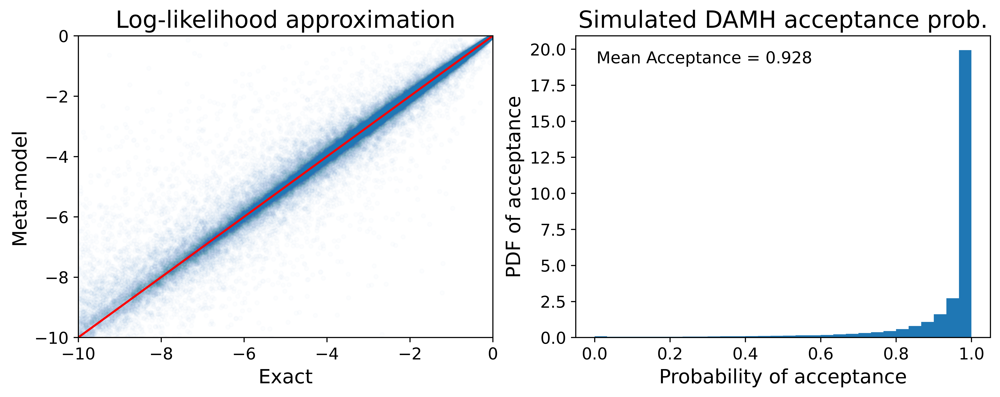

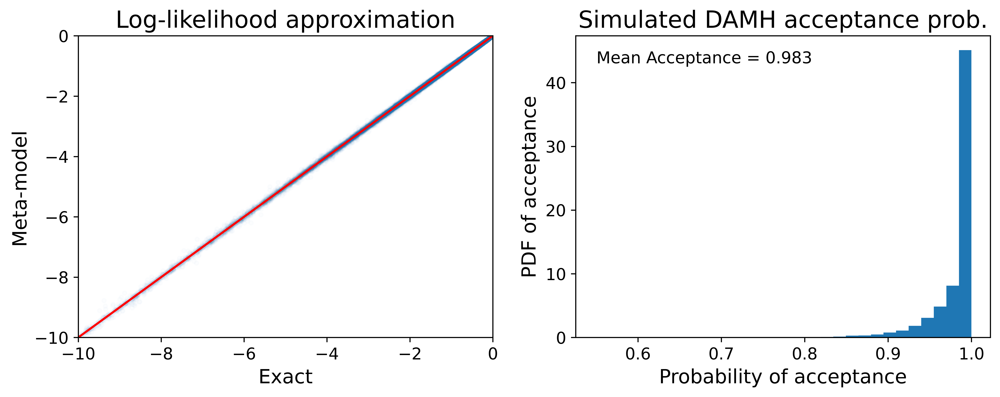

In [171]:

# Step 3: Define a Loss Function and Optimizer
criterion = nn.L1Loss()
optimizer = optim.Adam(model.parameters(), lr=0.02)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=1000, factor=0.75)
break_the_loop = False
# Step 5: Train the Model
max_iter = 2000000
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if (iteration + 1) % 1000 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-3:
                print(" (STOP)")
                break_the_loop = True
        if break_the_loop:
            break
        print(".")
        

# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)

In [12]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

n_lyer = 250
# Step 1: Define the Neural Network Architecture
class MLPRegressor(nn.Module):
    def __init__(self):
        super(MLPRegressor, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], n_lyer),
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, y_train.shape[1])
        )
        
    def forward(self, x):
        return self.layers(x)
    
# Step 2: Move the Model to GPU if Available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using {device} device')
model = MLPRegressor().to(device)

# Step 3: Define a Loss Function and Optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.01)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=20000, factor=0.75)

# Step 4: Convert Numpy Data to PyTorch Tensors and Move to Device
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)

break_the_loop = False

# Step 5: Train the Model
max_iter = 2000000
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if (iteration + 1) % 10000 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-4:
                print(" (STOP)")
                break_the_loop = True
        if break_the_loop:
            break
        print(".")
        

# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)


Using cuda device
Iteration 9999, Loss: 0.45734506845474243, Learning rate: 0.01.
Iteration 19999, Loss: 0.3176345229148865, Learning rate: 0.01.
Iteration 29999, Loss: 0.13018469512462616, Learning rate: 0.01.
Iteration 39999, Loss: 0.06766729801893234, Learning rate: 0.01.
Iteration 49999, Loss: 0.07630323618650436, Learning rate: 0.01.
Iteration 59999, Loss: 0.02026502415537834, Learning rate: 0.01.
Iteration 69999, Loss: 0.01620841585099697, Learning rate: 0.01.
Iteration 79999, Loss: 0.028326382860541344, Learning rate: 0.01.
Iteration 89999, Loss: 0.018060611560940742, Learning rate: 0.01.
Iteration 99999, Loss: 0.01180898305028677, Learning rate: 0.01.
Iteration 109999, Loss: 0.014186128042638302, Learning rate: 0.01.
Iteration 119999, Loss: 0.19896525144577026, Learning rate: 0.01.
Iteration 129999, Loss: 0.010240437462925911, Learning rate: 0.01.
Iteration 139999, Loss: 0.009699076414108276, Learning rate: 0.01.
Iteration 149999, Loss: 0.00877500232309103, Learning rate: 0.01.

KeyboardInterrupt: 

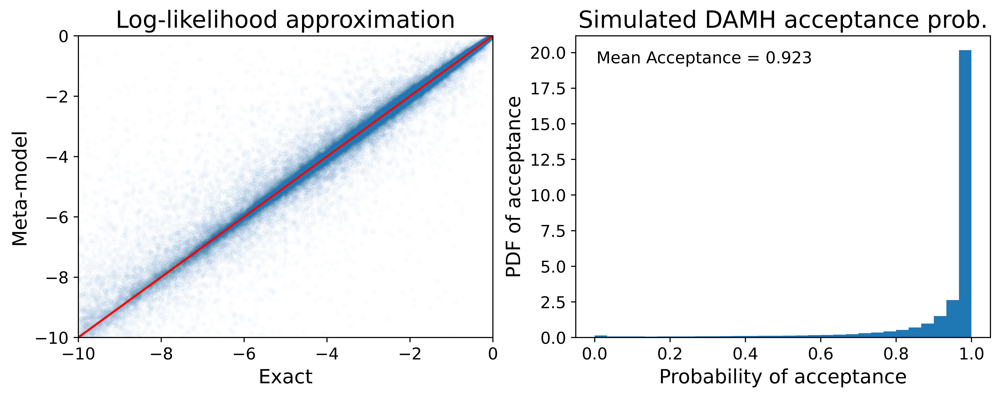

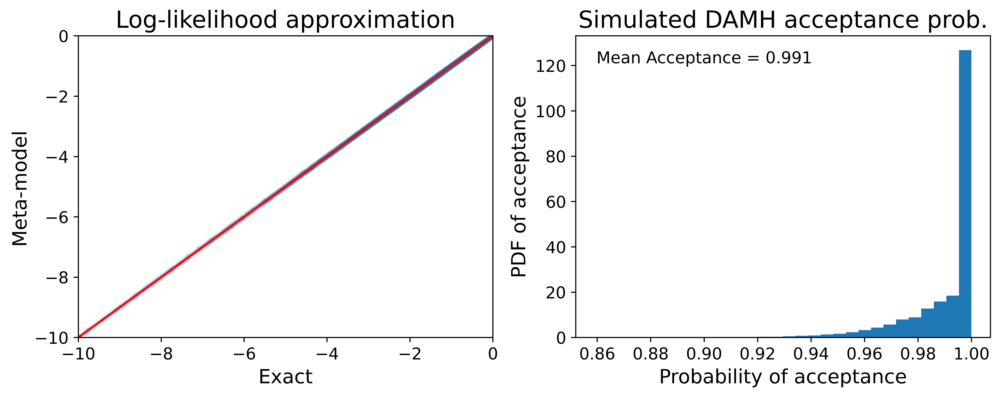

In [168]:
# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)


In [133]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np

n_lyer = 100
# Step 1: Define the Neural Network Architecture
class MLPRegressor(nn.Module):
    def __init__(self):
        super(MLPRegressor, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], n_lyer),
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),            
            nn.Linear(n_lyer, n_lyer),            
            nn.Linear(n_lyer, y_train.shape[1])
        )
        
    def forward(self, x):
        return self.layers(x)
    
# Step 2: Move the Model to GPU if Available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using {device} device')
model = MLPRegressor().to(device)

# Step 3: Define a Loss Function and Optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.01)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=20000, factor=0.75)

# Step 4: Convert Numpy Data to PyTorch Tensors and Move to Device
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)

break_the_loop = False

# Step 5: Train the Model
max_iter = 2000000
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if (iteration + 1) % 10000 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-4:
                print(" (STOP)")
                break_the_loop = True
        if break_the_loop:
            break
        print(".")
        

# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)


Using cuda device
Iteration 9999, Loss: 1.5335537195205688, Learning rate: 0.01.
Iteration 19999, Loss: 0.7300580739974976, Learning rate: 0.01.
Iteration 29999, Loss: 0.4446605145931244, Learning rate: 0.01.
Iteration 39999, Loss: 0.5101845264434814, Learning rate: 0.01.
Iteration 49999, Loss: 0.5053126811981201, Learning rate: 0.0075.
Iteration 59999, Loss: 0.3297988772392273, Learning rate: 0.0075.
Iteration 69999, Loss: 0.6552768349647522, Learning rate: 0.005625.
Iteration 79999, Loss: 0.45726028084754944, Learning rate: 0.005625.


KeyboardInterrupt: 

In [47]:
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=5000, factor=0.75)

# Step 5: Train the Model
max_iter = 2000000
break_the_loop = False
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if loss < 0.017:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        print(" (STOP)")
        break
    
    if (iteration + 1) % 10000 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-5:
                print(" (STOP)")
                break_the_loop = True
        if break_the_loop:
            break
        print(".")

Iteration 9999, Loss: 0.018256301060318947, Learning rate: 0.00075.
Iteration 19999, Loss: 0.018232928588986397, Learning rate: 0.00075.
Iteration 29999, Loss: 0.018388256430625916, Learning rate: 0.0005625000000000001.
Iteration 39999, Loss: 0.018009889870882034, Learning rate: 0.00042187500000000005.
Iteration 49999, Loss: 0.018104737624526024, Learning rate: 0.00042187500000000005.
Iteration 59999, Loss: 0.018055902794003487, Learning rate: 0.00042187500000000005.
Iteration 69999, Loss: 0.017923902720212936, Learning rate: 0.00042187500000000005.
Iteration 79999, Loss: 0.017968391999602318, Learning rate: 0.00031640625000000006.
Iteration 89999, Loss: 0.017902540042996407, Learning rate: 0.00031640625000000006.
Iteration 99999, Loss: 0.0179307758808136, Learning rate: 0.00031640625000000006.
Iteration 109999, Loss: 0.01785338670015335, Learning rate: 0.00031640625000000006.
Iteration 119999, Loss: 0.017878690734505653, Learning rate: 0.00031640625000000006.
Iteration 129999, Loss: 0

KeyboardInterrupt: 

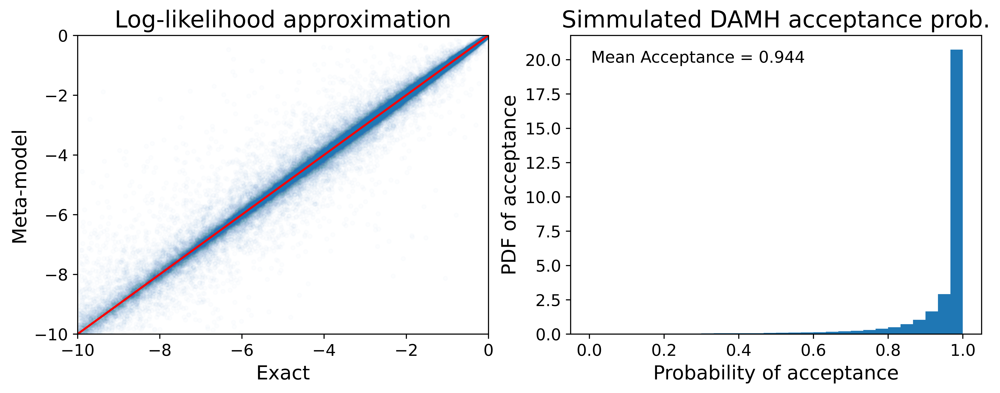

In [48]:
# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

In [ ]:
# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)

Using cuda device
Epoch [1/50000], Loss: 6588.7754, min Loss reached inf, stagnating for 0 it.
Epoch [2/50000], Loss: 2944.1975, min Loss reached 6588.7754, stagnating for 0 it.
Epoch [3/50000], Loss: 556.9185, min Loss reached 2944.1975, stagnating for 0 it.
Epoch [4/50000], Loss: 343.7981, min Loss reached 556.9185, stagnating for 0 it.
Epoch [5/50000], Loss: 227.2619, min Loss reached 343.7981, stagnating for 0 it.
Epoch [6/50000], Loss: 194.9692, min Loss reached 227.2619, stagnating for 0 it.
Epoch [7/50000], Loss: 193.9568, min Loss reached 194.9692, stagnating for 0 it.
Epoch [8/50000], Loss: 169.6842, min Loss reached 193.9568, stagnating for 0 it.
Epoch [9/50000], Loss: 171.7085, min Loss reached 169.6842, stagnating for 0 it.
Epoch [10/50000], Loss: 163.9919, min Loss reached 169.6842, stagnating for 1 it.
Epoch [11/50000], Loss: 149.3323, min Loss reached 163.9919, stagnating for 0 it.
Epoch [12/50000], Loss: 141.5799, min Loss reached 149.3323, stagnating for 0 it.
Epoch [1

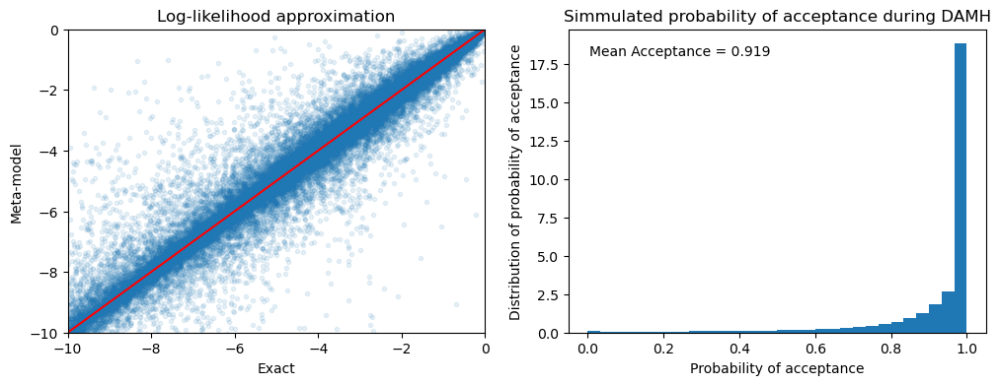

In [55]:
import torch
from torch import nn
from torch.autograd import Variable
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt

# Creating a simple neural network in PyTorch

n_lyer = 1000

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(X_train.shape[1], n_lyer),
            nn.ReLU(),
            nn.Linear(n_lyer, n_lyer),
            nn.ReLU(),
            nn.Linear(n_lyer, y_train.shape[1])
        )
        
    def forward(self, x):
        return self.layers(x)


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using {device} device')
# Create the model
model = Net().to(device)

# Convert data to PyTorch tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)

# Create DataLoader for the training set
dataset = TensorDataset(X_train_tensor, y_train_tensor)
dataloader = DataLoader(dataset, batch_size=2048, shuffle=True)  # Adjust the batch size



# Define the loss function and the optimizer
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.1)  # Decrease the learning rate

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=100, factor=0.8)

# Train the model
num_epochs = 50000
best_loss = np.inf
patience, trials = 1000, 0

for epoch in range(num_epochs):
    for inputs, targets in dataloader:
        # forward
        outputs = model(inputs)
        loss = criterion(outputs, targets)

        # backward and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Adjust the learning rate based on the loss
    scheduler.step(loss)

    print('Epoch [{}/{}], Loss: {:.4f}, min Loss reached {:.4f}, stagnating for {} it.'.format(epoch + 1, num_epochs, loss.item(), best_loss, trials))

    # Early stopping
    if loss.item() < best_loss:
        best_loss = loss.item()
        trials = 0
    else:
        trials += 1
        if trials >= patience:
            print(f'Stopping early at epoch {epoch+1}')
            break

# Test the model
model.eval()
with torch.no_grad():
    res_surr = model(X_test_tensor).detach().cpu().numpy()


# Compute alphas and plot results
plot_results_all(res_surr)


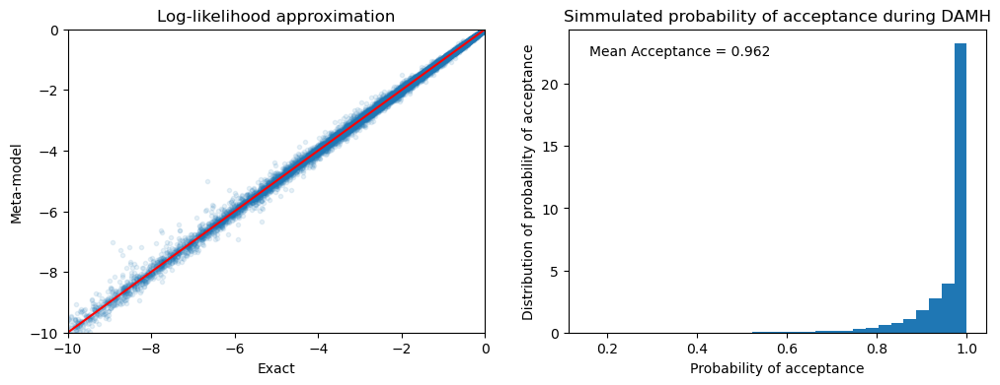

In [56]:
X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)

Epoch [1/200000], Loss: 82.4247, min Loss reached inf, stagnating for 0 it.
Epoch [101/200000], Loss: 8.8880, min Loss reached 8.4060, stagnating for 4 it.
Epoch [201/200000], Loss: 7.7325, min Loss reached 7.4987, stagnating for 10 it.
Epoch [301/200000], Loss: 7.4340, min Loss reached 6.6639, stagnating for 2 it.
Epoch [401/200000], Loss: 6.5979, min Loss reached 6.5915, stagnating for 0 it.
Epoch [501/200000], Loss: 6.6770, min Loss reached 5.9879, stagnating for 17 it.
Epoch [601/200000], Loss: 6.2347, min Loss reached 5.7082, stagnating for 43 it.
Epoch [701/200000], Loss: 7.2393, min Loss reached 5.3897, stagnating for 21 it.
Epoch [801/200000], Loss: 5.9670, min Loss reached 4.8270, stagnating for 8 it.
Epoch [901/200000], Loss: 4.4346, min Loss reached 4.4024, stagnating for 45 it.
Epoch [1001/200000], Loss: 3.8062, min Loss reached 3.7183, stagnating for 12 it.
Epoch [1101/200000], Loss: 4.6168, min Loss reached 3.3988, stagnating for 71 it.
Epoch [1201/200000], Loss: 3.2472, 

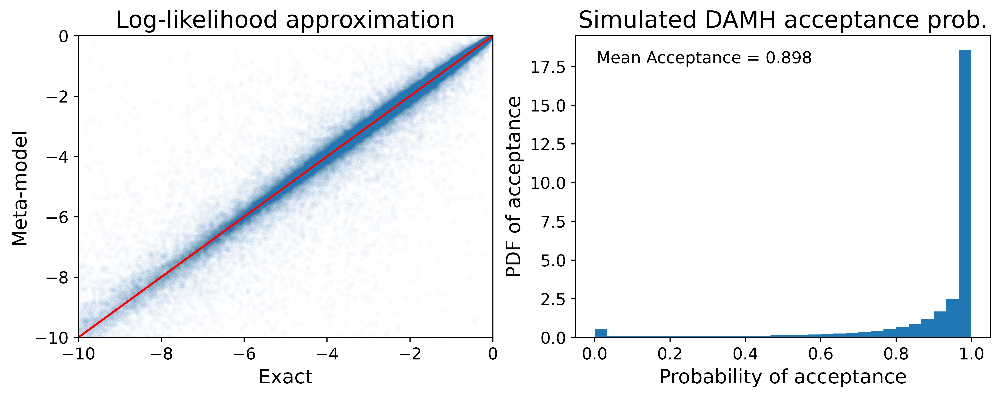

In [39]:
import torch
from torch import nn
from torch.autograd import Variable
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt

# Creating a simple neural network in PyTorch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
n = 100


class Net(nn.Module):
    def __init__(self, input_size, output_size):
        super(Net, self).__init__()
        self.fc1 = nn.Linear(input_size, n)
        self.fc2 = nn.Linear(n, n)
        self.fc3 = nn.Linear(n, n)
        self.fc4 = nn.Linear(n, n)
        self.fc5 = nn.Linear(n, n)
        self.fc6 = nn.Linear(n, n)
        self.fc7 = nn.Linear(n, output_size)
        self.relu = nn.LeakyReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = self.relu(self.fc4(x))
        x = self.relu(self.fc5(x))
        x = self.relu(self.fc6(x))
        x = self.fc7(x)
        return x


# Convert data to PyTorch tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)


# Create the model
model = Net(X_train.shape[1], y_train.shape[1]).to(device)

# Define the loss function and the optimizer
criterion = nn.SmoothL1Loss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.1)  # Decrease the learning rate

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=100, factor=0.95)

# Train the model
num_epochs = 200000
best_loss = np.inf
patience, trials = 2000, 0

for epoch in range(num_epochs):

    # forward
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)

    # backward and optimize
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    # Adjust the learning rate based on the loss
    scheduler.step(loss)
    if epoch % 100 == 0:
        print('Epoch [{}/{}], Loss: {:.4f}, min Loss reached {:.4f}, stagnating for {} it.'.format(epoch +
          1, num_epochs, loss.item(), best_loss, trials))

    # Early stopping
    if loss.item() < best_loss:
        best_loss = loss.item()
        trials = 0
    else:
        trials += 1
        if trials >= patience:
            print(f'Stopping early at epoch {epoch+1}')
            break

# Test the model
model.eval()
with torch.no_grad():
    y_pred_tensor = model(X_test_tensor)

# Convert tensor to numpy array
res_surr = y_pred_tensor.detach().cpu().numpy()


# Compute alphas and plot results
plot_results_all(res_surr)

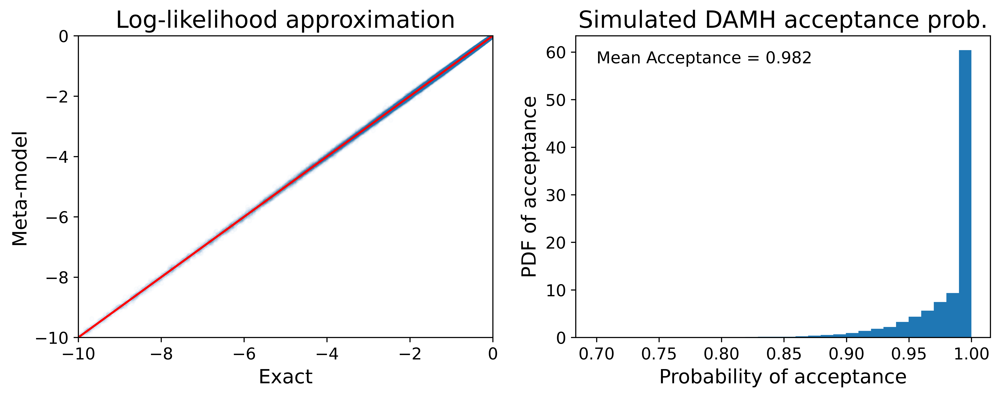

In [18]:
# Test the model
model.eval()
with torch.no_grad():
    y_pred_tensor = model(X_train_tensor)

# Convert tensor to numpy array
res_surr = y_pred_tensor.detach().cpu().numpy()


# Compute alphas and plot results
plot_results_all_train(res_surr)

In [ ]:
# Test the model
model.eval()
with torch.no_grad():
    y_pred_tensor = model(X_test_tensor)

# Convert tensor to numpy array
res_surr = y_pred_tensor.detach().cpu().numpy()


# Compute alphas and plot results
plot_results_all(res_surr)

In [116]:
print(X_train_tensor.shape)
print(y_train_tensor.shape)

torch.Size([15123, 8])
torch.Size([15123, 26])


In [51]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import torch.nn.init as init

# Define the LSTM Model
# Step 2: Move the Model to GPU if Available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using {device} device')

# Instantiate the model, define the loss function and the optimizer
class LSTMModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers):
        super(LSTMModel, self).__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        
        # Define the LSTM layer
        self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers, batch_first=True)
        
        # Define the output layer as a 1D convolutional layer
        self.conv1d = nn.Conv1d(1, 1, kernel_size=10)
        
        # Define a linear layer to reduce the output size to output_dim
        self.linear = nn.Linear(hidden_dim, output_dim)
        self.relu = nn.Tanh()

    def forward(self, x):
        # Initialize hidden state with zeros
        h_0 = torch.zeros(self.num_layers, x.size(0), self.hidden_dim).to(x.device)
        c_0 = torch.zeros(self.num_layers, x.size(0), self.hidden_dim).to(x.device)
        
        # We need to detach as we are doing truncated backpropagation through time (BPTT)
        # If we don't, we'll backprop all the way to the start even after going through another batch 
        out, (hn, cn) = self.lstm(x)
        
        # Index hidden state of last time step and add an extra dimension
        
        
        # out = self.linear(self.relu(out.squeeze(1)))
        # Pass the output through the 1D convolutional layer
        out = self.linear(out)
        
        # Remove the extra dimension and pass the output through the linear layer
        
        
        return out.squeeze(1)

# Define the input dimensions
input_dim = 8
hidden_dim = 200
output_dim = 26
num_layers = 1

# Create the model
model = LSTMModel(input_dim, hidden_dim, output_dim, num_layers)
model = model.to(device)
criterion = nn.SmoothL1Loss()
optimizer = optim.Adam(model.parameters(), lr=0.1)

# Add a learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2000, factor=0.75)

# Step 4: Convert Numpy Data to PyTorch Tensors and Move to Device
X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).to(device)
X_train_tensor = X_train_tensor.unsqueeze(1)
# Rest of your code for training and testing the model...



break_the_loop = False

# Step 5: Train the Model
max_iter = 2000000
for iteration in range(max_iter):
    optimizer.zero_grad()
    outputs = model(X_train_tensor)
    loss = criterion(outputs, y_train_tensor)
    loss.backward()
    optimizer.step()
    scheduler.step(loss)
    
    if (iteration + 1) % 100 == 0:
        print(f'Iteration {iteration}, Loss: {loss.item()}, ', end='')
        # print current learning rate
        for param_group in optimizer.param_groups:
            print(f'Learning rate: {param_group["lr"]}', end='')
            if param_group['lr'] < 1e-4:
                print(" (STOP)")
                break_the_loop = True
        if break_the_loop:
            break
        print(".")
        

# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)


Using cuda device
Iteration 99, Loss: 9.861382484436035, Learning rate: 0.1.
Iteration 199, Loss: 4.0454888343811035, Learning rate: 0.1.
Iteration 299, Loss: 1.4366134405136108, Learning rate: 0.1.
Iteration 399, Loss: 1.014471411705017, Learning rate: 0.1.
Iteration 499, Loss: 0.8443180918693542, Learning rate: 0.1.
Iteration 599, Loss: 0.654626190662384, Learning rate: 0.1.
Iteration 699, Loss: 0.60361248254776, Learning rate: 0.1.
Iteration 799, Loss: 0.5815035700798035, Learning rate: 0.1.
Iteration 899, Loss: 0.5135736465454102, Learning rate: 0.1.
Iteration 999, Loss: 0.5392767190933228, Learning rate: 0.1.
Iteration 1099, Loss: 0.4597327709197998, Learning rate: 0.1.
Iteration 1199, Loss: 0.4553975760936737, Learning rate: 0.1.
Iteration 1299, Loss: 0.4232848584651947, Learning rate: 0.1.
Iteration 1399, Loss: 0.41640034317970276, Learning rate: 0.1.
Iteration 1499, Loss: 0.3983469605445862, Learning rate: 0.1.
Iteration 1599, Loss: 0.3682612478733063, Learning rate: 0.1.
Itera

KeyboardInterrupt: 

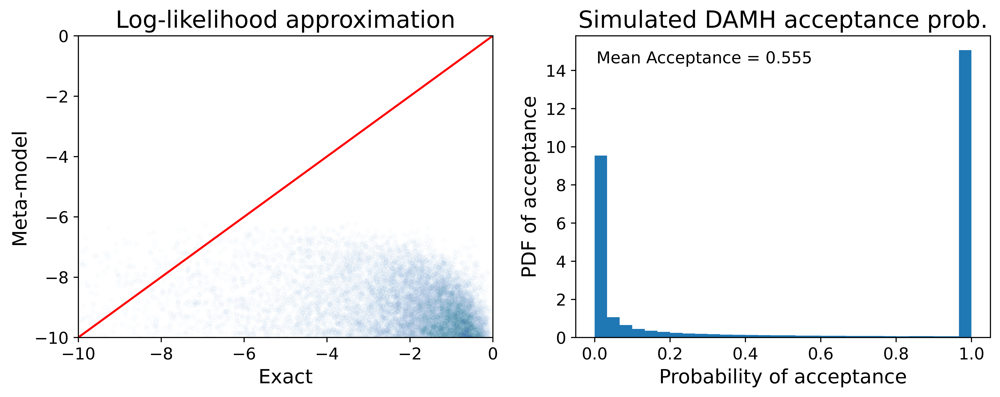

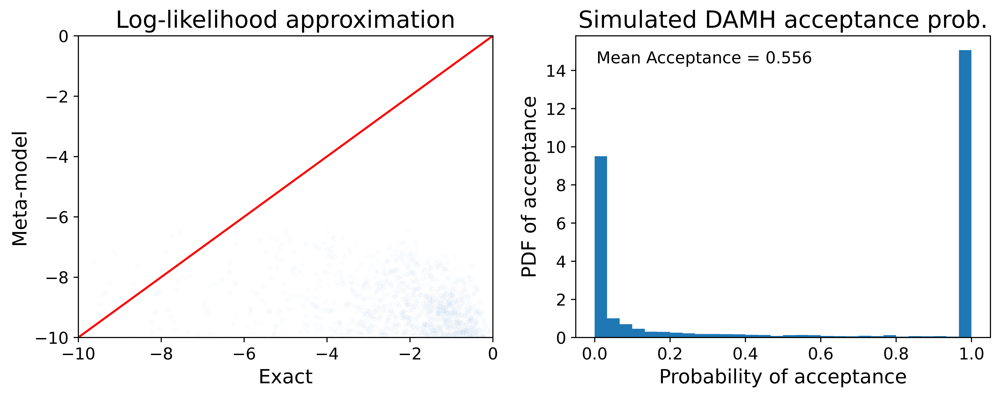

In [52]:
# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

X_test_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all_train(res_surr)

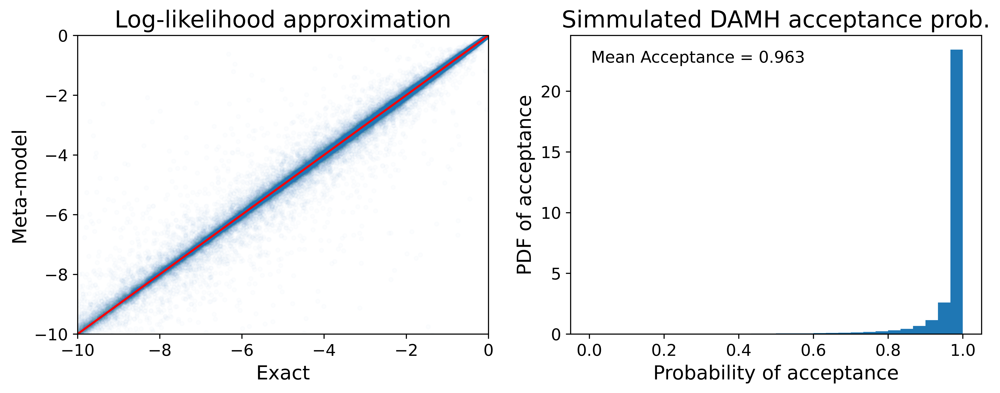

In [139]:
# Step 6: Test the Model
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
X_test_tensor = X_test_tensor.unsqueeze(1)
res_surr = model(X_test_tensor).detach().cpu().numpy()

# Step 7: Plot the Results
# Replace 'plot_results_all' with your own plotting function
plot_results_all(res_surr)

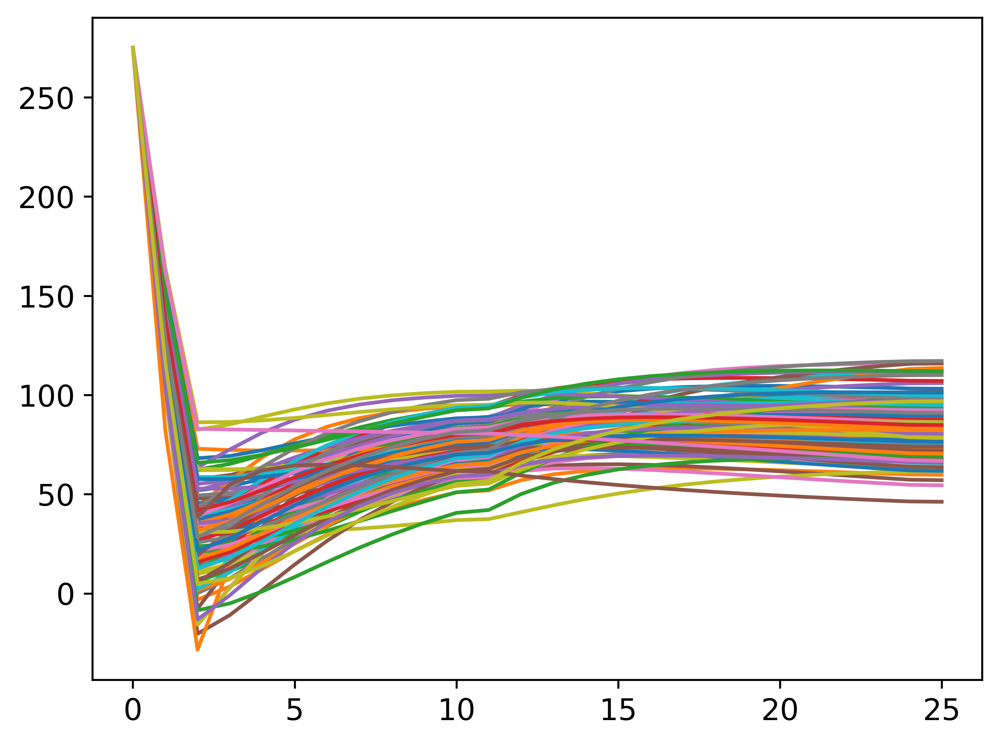

In [152]:
plt.plot(y_test[1:100,:].T)

